In [47]:
import pandas as pd #lectura de datos
import numpy as np # biblioteca con operaciones matemáticas y algebra lineal
import mysql.connector # importar la base de datos

#viz y plots bonitos
import matplotlib.pyplot as plt
import seaborn as sbn
plt.style.use('ggplot')
font = {'family' : 'sans',
        'weight' : 'bold',
        'size'   : 16}
plt.rc('font', **font)
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams[u'figure.figsize'] = (12,10)
import plotly
import cufflinks

import plotly.express as px
import plotly.io as pio
import bar_chart_race as bcr
# necesario instalar ffmepg, hit utiliza conda...! funciona

# preprocesamiento de datos
from sklearn.model_selection import train_test_split
from sklearn.utils import resample

#tuneo de metaparametros
from imblearn.over_sampling import SMOTE

# Modelos
import lightgbm as lgb

# metricas de evaluacion
from sklearn.metrics import (roc_auc_score, classification_report, confusion_matrix,
                            roc_curve, accuracy_score)
# lo mismo pero en grafico
import scikitplot as skplt

# Interpretacion
import shap

In [9]:
cnx = mysql.connector.connect(
        user='ligamx_scrapper', 
        password='1234qwer', # note apures... nunca uso esa contrasenia :v
        host='localhost',
        database='ligamx')

#https://github.com/geroblesv/ligamx_scrapper   de aqui es el scrapper

In [10]:
# Lectura de datos desde la tabla
df = pd.read_sql_query("SELECT * FROM ligamx.match;", con=cnx)
df["match_date"] = pd.to_datetime(df.match_date)
df = df.sort_values('match_date').reset_index(drop=True) # se ordena de lo mas viejo a lo mas nuevo en partidos
# Variable si depende del mes y dia que juegan
df["match_year"] = df.match_date.dt.year
dict_month = {1:'Enero',2:'Febrero',3:'Marzo',4:'Abril',5:'Mayo',6:'Junio',7:'Julio',
             8:'Agosto',9:'Septiembre',10:'Octubre',11:'Noviembre',12:'Diciembre'}
df["match_month"] = df.match_date.dt.month.map(dict_month)
dict_day = {0:'Lunes',1:'Martes',2:'Miercoles',3:'Jueves',4:'Viernes',5:'Sabado',6:'Domingo'}
df["match_diasemana"] = df.match_date.dt.weekday.map(dict_day)
# Checamos que los nombres no esten repetidos
team_dict = {'Gallos Blancos':'Club Queretaro','Laguna':'Santos','América':'America',
             'Atlético Español':'Atletico Espanol','León':'Leon','Ángeles':'Angeles',
            'Club Querétaro':'Club Queretaro','Atlético de San Luis':'Atletico de San Luis',
            'FC Juárez':'FC Juarez'}
df.home_team = df.home_team.apply(lambda x: team_dict.get(x,x))
df.away_team = df.away_team.apply(lambda x: team_dict.get(x,x))
# Guardamos el resultado que sera nuestra variable a predecir al hacerlo multiclase
df['resultado'] = np.where(df.home_score > df.away_score, 'local',
                          np.where(df.home_score == df.away_score, 'empate',
                                  'visitante'))
# Resultado en formato
df['FT'] = df.home_score.astype(str) + '-' + df.away_score.astype(str)

In [11]:
# Se crea la variable a predecir
df['ganador'] = np.where(df.home_score > df.away_score, df.home_team,
                          np.where(df.home_score == df.away_score, 'empate',
                                  df.away_team))

# Como es nuestra variable objetivo

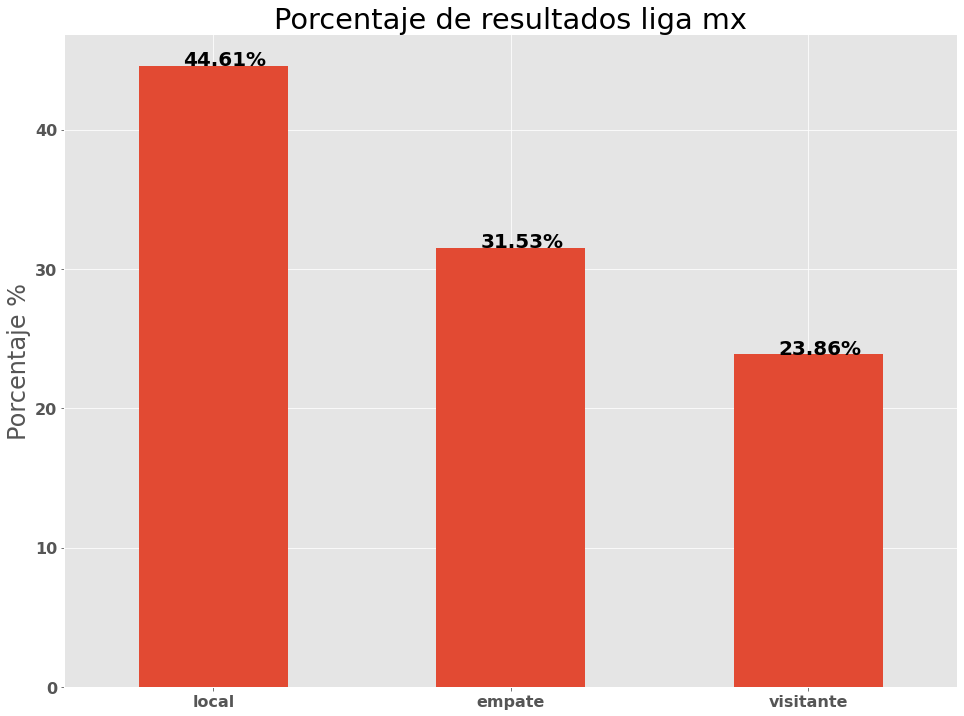

In [13]:
res = df.resultado.value_counts(normalize=True) * 100
res.plot.bar(rot=0, title='Porcentaje de resultados liga mx')
plt.ylabel('Porcentaje %')
for ind,i in enumerate(res.values):
    plt.text(ind-0.1,i,str(round(i,2))+'%')

Hagamos mas cosas y ahorita regresamos a ti!

# Solo por hobbie hagamos una carrera de barras

In [16]:
# creamos un par de columnas para mejorar la visualizacion
df['year_month'] = pd.to_datetime(df.match_date).dt.to_period('m')
df['es_liguilla'] = np.where(df.match_name.str[:7] != 'Jornada',1,0)

In [17]:
# Preprocesamiento de datos.
df_bar_race = df[df['es_liguilla'] != 1]
df_bar_race = df.groupby("year_month").ganador.value_counts().unstack(1)
df_bar_race = df_bar_race.reset_index().set_index("year_month").fillna(0).cumsum()
df_bar_race.index = df_bar_race.index.to_timestamp()
df_bar_race.drop(['empate','Angeles','Atletico Espanol','Campesinos','Cobras','Correcaminos',
                 'Cuernavaca','Indios','La Piedad','Tampico Madero','Atletico de San Luis'],axis=1,inplace=True)

In [20]:
# Cosas de la carrera de barras
def period_summary(values, ranks):
    top2 = values.nlargest(2)
    leader = top2.index[0]
    lead = top2.iloc[0] - top2.iloc[1]
    s = f'{leader} by {lead:.0f}'
    return {'s': s, 'x': .95, 'y': .07, 'ha': 'right', 'size': 8}

bcr.bar_chart_race(df=df_bar_race, 
                   filename= None, #'ligamx_winners.mp4', 
                   n_bars=10, 
                   period_fmt = ' %B %Y', 
                   title='Partidos ganados acumulados de la Liga MX 1975-2019 sin liguillas',
                   bar_label_size=7,
                   tick_label_size=8,
                   steps_per_period=6,
                   bar_kwargs={'alpha': .7},
                   period_summary_func=period_summary,
                   perpendicular_bar_func='median',
                   scale='linear',
                   cmap=['yellow','blue','gold','red','navy','red','aqua',
                   'brown','red','snow','greenyellow','aqua','orangered',
                   'deepskyblue','limegreen','lightcoral','b','darkred','navy','white',
                   'chocolate','lawngreen','darksalmon','silver','gray','navy','lightgreen','firebrick',
                   'royalblue','w','cornflowerblue','dodgerblue','olive','palegreen'
                   ,'yellow','r','crimson','chartreuse','seashell'],
                   filter_column_colors=False)

Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 


# Probabilidad marginal de goles por partido

Se busca hacer un analisis de la probabilidad de que si el local anota n goles cuantos anotara el visitante.

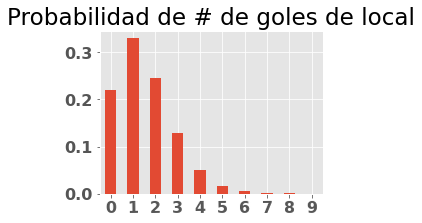

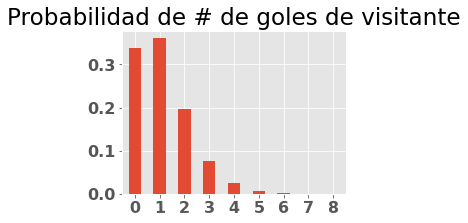

In [56]:
plt.subplots()
df[['home_score',"away_score"]].home_score.value_counts(normalize=True).sort_index().plot.bar(figsize=(4,3), rot=True, title="Probabilidad de # de goles de local")
plt.subplots()
df[['home_score',"away_score"]].away_score.value_counts(normalize=True).sort_index().plot.bar(figsize=(4,3), rot=True, title="Probabilidad de # de goles de visitante")

In [79]:
df[['home_score',"away_score"]].groupby('home_score')['away_score'].value_counts(normalize=False).unstack()

away_score,0,1,2,3,4,5,6,7,8
home_score,,,,,,,,,
0,1393.0,792.0,419.0,162.0,49.0,12.0,NaN,NaN,NaN
1,1281.0,1748.0,770.0,296.0,102.0,17.0,7.0,1.0,NaN
2,907.0,1174.0,705.0,262.0,77.0,21.0,3.0,1.0,2.0
3,444.0,570.0,413.0,165.0,46.0,10.0,1.0,NaN,NaN
4,199.0,234.0,129.0,59.0,23.0,5.0,NaN,NaN,NaN
5,63.0,73.0,53.0,14.0,5.0,2.0,NaN,NaN,NaN
6,23.0,19.0,19.0,6.0,2.0,NaN,1.0,NaN,NaN
7,6.0,8.0,4.0,1.0,NaN,NaN,NaN,NaN,NaN
8,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [83]:
# hay resultados muy improbables, se quitan del analisis
mask = (df.home_score < 7) & (df.away_score < 6)
df_prob_goles = df[mask][['home_score',"away_score"]].groupby('home_score')['away_score'].value_counts(normalize=True).unstack() * 100
df_prob_goles = df_prob_goles.fillna(0)
df_prob_goles

away_score,0,1,2,3,4,5
home_score,,,,,,
0,49.274850,28.015564,14.821365,5.730456,1.733286,0.424478
1,30.398671,41.480778,18.272425,7.024205,2.420503,0.403417
2,28.830261,37.317228,22.409409,8.328036,2.447552,0.667514
3,26.941748,34.587379,25.060680,10.012136,2.791262,0.606796
4,30.662558,36.055470,19.876733,9.090909,3.543914,0.770416
5,30.000000,34.761905,25.238095,6.666667,2.380952,0.952381
6,33.333333,27.536232,27.536232,8.695652,2.898551,0.000000


Text(0.5, 1.0, 'Probabilidad del resultado')

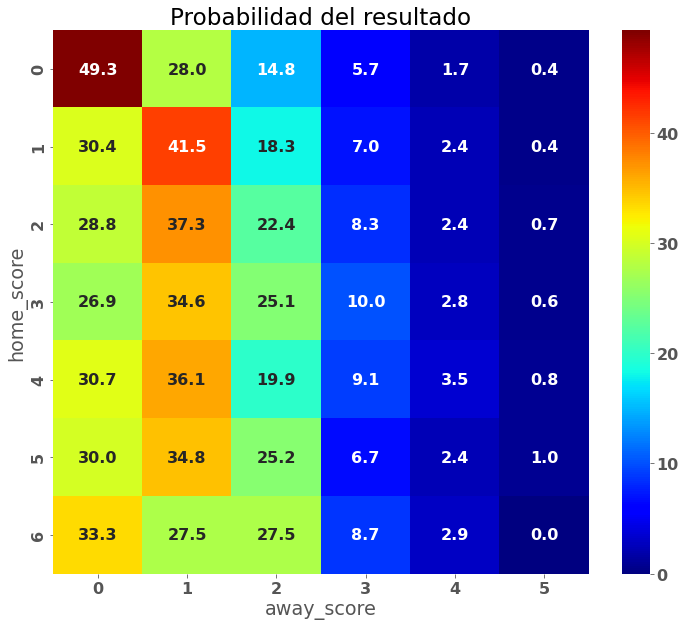

In [84]:
sbn.heatmap(df_prob_goles, annot=True, cmap='jet',fmt='.1f')
plt.title("Probabilidad del resultado")

## Esto mismo de proba de resultado pero por equipo ya sea de local o visitante

### Local

In [131]:
equipos = ['America', 'Monterrey','Toluca', 'Atlas', 'Chivas',
          'Cruz Azul', 'Tigres', 'Leon', 'Atlante','Santos', 
           'Pumas','Morelia','Necaxa']

mask1 = (df.home_score < 7) & (df.away_score < 6)
mask2 = (df.home_team.isin(equipos)) & (df.away_team.isin(equipos))
df_prob_goles = df[mask1 & mask2]
df_prob_goles = df_prob_goles[['home_team','away_team','home_score',"away_score"]].groupby(['home_team','away_team','home_score'])['away_score'].value_counts(normalize=True).unstack() * 100
df_prob_goles = df_prob_goles.fillna(0)

In [132]:
temp = pd.DataFrame(df_prob_goles.stack().reset_index())
temp.head()

,home_team,away_team,home_score,away_score,0
0,America,Atlante,0,0,33.333333
1,America,Atlante,0,1,66.666667
2,America,Atlante,0,2,0.000000
3,America,Atlante,0,3,0.000000
4,America,Atlante,0,4,0.000000


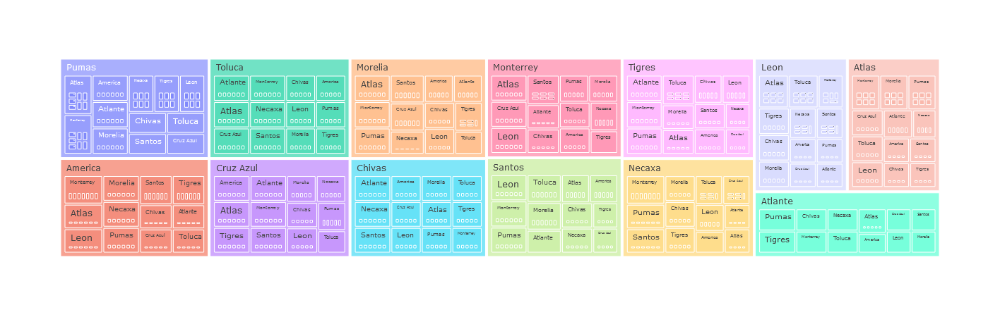

In [133]:
fig = px.treemap(temp, path=['home_team','away_team','home_score','away_score'], values=0,color_continuous_scale='RdBu')
fig.show()
pio.write_html(fig, file='prob_golesxequipos_delocal.html', auto_open=False)

### Visitante

In [134]:
df_prob_goles = df[mask1 & mask2]
df_prob_goles = df_prob_goles[['home_team','away_team','home_score',"away_score"]].groupby(['away_team','home_team','away_score'])['home_score'].value_counts(normalize=True).unstack() * 100
df_prob_goles = df_prob_goles.fillna(0)
temp = pd.DataFrame(df_prob_goles.stack().reset_index())

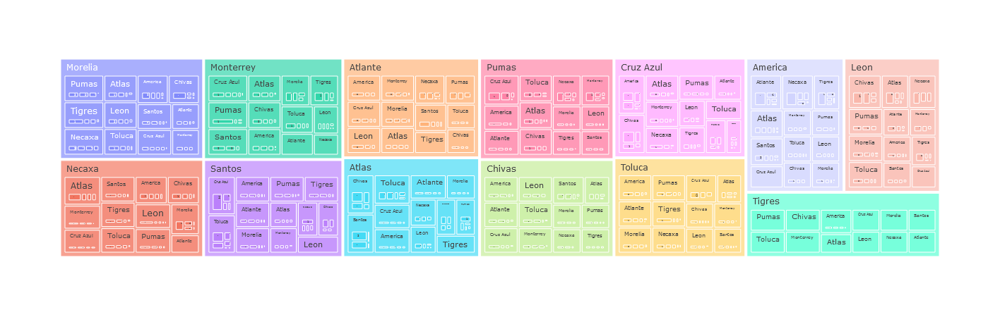

In [135]:
fig = px.treemap(temp, path=['home_team','away_team','home_score','away_score'], values=0,color_continuous_scale='RdBu')
fig.show()
pio.write_html(fig, file='prob_golesxequipos_de_visitante.html', auto_open=False)

# Generacion de variables

In [19]:
cols_checks = ['home_team', 'FT','away_team','resultado','historico_racha_ganadora_local','historico_racha_ganadora_visitante']
df.head()

,match_date,tournament_name,match_name,home_team,home_score,away_team,away_score,match_year,match_month,match_diasemana,resultado,FT,ganador,year_month,es_liguilla
0,1975-07-01,temporada 1975 1976,Jornada 36,America,2,Pumas,1,1975,Julio,Martes,local,2-1,America,1975-07,0
1,1975-07-03,temporada 1975 1976,Jornada 36,Monterrey,1,Estudiantes,2,1975,Julio,Jueves,visitante,1-2,Estudiantes,1975-07,0
2,1975-07-03,temporada 1975 1976,Jornada 36,Atletico Espanol,3,Atlante,0,1975,Julio,Jueves,local,3-0,Atletico Espanol,1975-07,0
3,1975-07-03,temporada 1975 1976,Jornada 36,Jalisco,3,Tigres,2,1975,Julio,Jueves,local,3-2,Jalisco,1975-07,0
4,1975-07-04,temporada 1975 1976,Jornada 36,Toluca,4,Zacatepec,0,1975,Julio,Viernes,local,4-0,Toluca,1975-07,0


## racha de partidos ganados

In [11]:
# suma de goles del equipo en el partido actual durante el torneo
df_racha = pd.DataFrame()
for tornament in df.tournament_name.unique():
    
    df_res = df[df.tournament_name == tornament]
    el = df_res.home_team.unique()

    df_res = df_res[['tournament_name','match_date','home_team','away_team', 'resultado','ganador', 'FT']]
    df_res['historico_racha_ganadora_local'] = np.nan
    df_res['historico_racha_ganadora_visitante'] = np.nan
    
    for e1 in el:

        num_ganes = 0
        ind_local = df_res[df_res.home_team == e1].index.values
        ind_visitante = df_res[df_res.away_team == e1].index.values
        ind = sorted(df_res[(df_res.home_team == e1) | (df_res.away_team == e1)].index.values)
        ind_mas_uno = 0

        for match in ind:
    
            # se ponen los goles anteriores al partido actual para evitar el future leak.
            if ind[ind_mas_uno] in ind_local:
                df_res.loc[ind[ind_mas_uno], 'historico_racha_ganadora_local'] = num_ganes
            elif ind[ind_mas_uno] in ind_visitante:
                df_res.loc[ind[ind_mas_uno], 'historico_racha_ganadora_visitante'] = num_ganes

            # suma de goles
            if match in ind_local:
                if df_res.loc[match, 'resultado'] == 'local':
                    num_ganes = num_ganes + 1
                    ind_mas_uno = ind_mas_uno + 1
                else:
                    num_ganes = 0
                    ind_mas_uno = ind_mas_uno + 1

            elif match in ind_visitante:
                if df_res.loc[match, 'resultado'] == 'visitante':
                    num_ganes = num_ganes + 1
                    ind_mas_uno = ind_mas_uno + 1
                else:
                    num_ganes = 0
                    ind_mas_uno = ind_mas_uno + 1

    df_racha = pd.concat([df_racha,df_res])

In [12]:
df_racha[(
    df_racha.home_team == 'Pumas')|(df_racha.away_team == 'Pumas')]

,tournament_name,match_date,home_team,away_team,resultado,ganador,FT,historico_racha_ganadora_local,historico_racha_ganadora_visitante
0,temporada 1975 1976,1975-07-01,America,Pumas,local,America,2-1,0.0,0.0
10,temporada 1975 1976,1975-07-08,Atletico Espanol,Pumas,local,Atletico Espanol,1-0,1.0,0.0
20,temporada 1975 1976,1975-07-15,Pumas,Leon,local,Pumas,3-2,0.0,1.0
30,temporada 1975 1976,1975-07-21,Curtidores,Pumas,local,Curtidores,3-0,0.0,1.0
33,temporada 1975 1976,1975-07-24,Pumas,Curtidores,local,Pumas,2-1,0.0,1.0
...,...,...,...,...,...,...,...,...,...
12755,apertura 2019,2019-10-26,Club Queretaro,Pumas,local,Club Queretaro,3-0,2.0,0.0
12764,apertura 2019,2019-10-29,Pumas,Atlas,local,Pumas,5-1,0.0,0.0
12770,apertura 2019,2019-11-01,Puebla,Pumas,empate,empate,1-1,0.0,1.0
12786,apertura 2019,2019-11-10,Pumas,FC Juarez,empate,empate,1-1,0.0,1.0


## racha de partidos invicto

In [13]:
# suma de goles del equipo en el partido actual durante el torneo
df_racha_invicto = pd.DataFrame()
for tornament in df.tournament_name.unique():
    
    df_res = df[df.tournament_name == tornament]
    el = df_res.home_team.unique()

    df_res = df_res[['tournament_name','match_date','home_team','away_team', 'resultado','ganador', 'FT']]
    df_res['historico_invicto_local'] = np.nan
    df_res['historico_invicto_visitante'] = np.nan
    
    for e1 in el:

        num_ganes = 0
        ind_local = df_res[df_res.home_team == e1].index.values
        ind_visitante = df_res[df_res.away_team == e1].index.values
        ind = sorted(df_res[(df_res.home_team == e1) | (df_res.away_team == e1)].index.values)
        ind_mas_uno = 0

        for match in ind:
    
            # se ponen los goles anteriores al partido actual para evitar el future leak.
            if ind[ind_mas_uno] in ind_local:
                df_res.loc[ind[ind_mas_uno], 'historico_invicto_local'] = num_ganes
            elif ind[ind_mas_uno] in ind_visitante:
                df_res.loc[ind[ind_mas_uno], 'historico_invicto_visitante'] = num_ganes

            # suma de goles
            if match in ind_local:
                if df_res.loc[match, 'resultado'] in ['local','empate']:
                    num_ganes = num_ganes + 1
                    ind_mas_uno = ind_mas_uno + 1
                else:
                    num_ganes = 0
                    ind_mas_uno = ind_mas_uno + 1

            elif match in ind_visitante:
                if df_res.loc[match, 'resultado'] in ['visitante','empate']:
                    num_ganes = num_ganes + 1
                    ind_mas_uno = ind_mas_uno + 1
                else:
                    num_ganes = 0
                    ind_mas_uno = ind_mas_uno + 1

    df_racha_invicto = pd.concat([df_racha_invicto,df_res])

In [14]:
df_racha_invicto[(
    df_racha_invicto.home_team == 'Pumas')|(df_racha_invicto.away_team == 'Pumas')].tail(18)

,tournament_name,match_date,home_team,away_team,resultado,ganador,FT,historico_invicto_local,historico_invicto_visitante
12629,apertura 2019,2019-07-20,Atletico de San Luis,Pumas,visitante,Pumas,0-2,0.0,0.0
12643,apertura 2019,2019-07-28,Pumas,Necaxa,local,Pumas,2-0,1.0,1.0
12651,apertura 2019,2019-08-04,Pumas,Tigres,visitante,Tigres,0-1,2.0,0.0
12655,apertura 2019,2019-08-09,Club Tijuana,Pumas,local,Club Tijuana,1-0,0.0,0.0
12668,apertura 2019,2019-08-18,Pumas,Veracruz,local,Pumas,2-0,0.0,0.0
12672,apertura 2019,2019-08-23,Morelia,Pumas,local,Morelia,2-0,0.0,1.0
12688,apertura 2019,2019-08-29,Monterrey,Pumas,local,Monterrey,2-0,0.0,0.0
12695,apertura 2019,2019-09-01,Pumas,Toluca,local,Pumas,2-1,0.0,2.0
12701,apertura 2019,2019-09-14,America,Pumas,empate,empate,1-1,0.0,1.0
12715,apertura 2019,2019-09-22,Pumas,Cruz Azul,empate,empate,1-1,2.0,2.0


## Historico goles

In [15]:
cols_checks = ['tournament_name','home_team', 'FT','away_team','resultado','historico_goles_local','historico_goles_visitante']

In [16]:
# suma de goles del equipo en el partido actual durante el torneo
df_goles = pd.DataFrame()
for tornament in df.tournament_name.unique():
    df_res = df[df.tournament_name == tornament]
    el = df_res.home_team.unique()
    df_res = df_res[['tournament_name','match_date','home_team','away_team',
                     'home_score','away_score','resultado','ganador', 'FT']]
    df_res['historico_goles_local'] = np.nan
    df_res['historico_goles_visitante'] = np.nan

    for e1 in el:
        
        try:
            goles = 0
            ind_local = df_res[df_res.home_team == e1].index.values
            ind_visitante = df_res[df_res.away_team == e1].index.values
            ind = sorted(df_res[(df_res.home_team == e1) | (df_res.away_team == e1)].index.values)
            ind_mas_uno = 0

            for match in ind:
                # suma de goles
                if match in ind_local:
                    goles = goles + df_res.loc[match,'home_score']
                    ind_mas_uno = ind_mas_uno + 1        
                elif match in ind_visitante:
                    goles = goles + df_res.loc[match, 'away_score']
                    ind_mas_uno = ind_mas_uno + 1

                # se ponen los goles anteriores al partido actual para evitar el future leak.
                if ind[ind_mas_uno] in ind_local:
                    df_res.loc[ind[ind_mas_uno], 'historico_goles_local'] = goles
                elif ind[ind_mas_uno] in ind_visitante:
                    df_res.loc[ind[ind_mas_uno], 'historico_goles_visitante'] = goles
        except IndexError:
            continue

    df_goles = pd.concat([df_goles,df_res])

In [17]:
df_goles[cols_checks][(df.tournament_name == 'apertura 2019' ) & ((
    df_goles.home_team == 'Pumas')|(df_goles.away_team == 'Pumas'))]

,tournament_name,home_team,FT,away_team,resultado,historico_goles_local,historico_goles_visitante
12629,apertura 2019,Atletico de San Luis,0-2,Pumas,visitante,NaN,NaN
12643,apertura 2019,Pumas,2-0,Necaxa,local,2.0,0.0
12651,apertura 2019,Pumas,0-1,Tigres,visitante,4.0,4.0
12655,apertura 2019,Club Tijuana,1-0,Pumas,local,5.0,4.0
12668,apertura 2019,Pumas,2-0,Veracruz,local,4.0,4.0
12672,apertura 2019,Morelia,2-0,Pumas,local,4.0,6.0
12688,apertura 2019,Monterrey,2-0,Pumas,local,9.0,6.0
12695,apertura 2019,Pumas,2-1,Toluca,local,6.0,4.0
12701,apertura 2019,America,1-1,Pumas,empate,11.0,8.0
12715,apertura 2019,Pumas,1-1,Cruz Azul,empate,9.0,10.0


## Goles en contra en cada partido

In [18]:
# suma de goles del equipo en el partido actual durante el torneo
df_goles_contra = pd.DataFrame()
for tornament in df.tournament_name.unique():
    df_res = df[df.tournament_name == tornament]
    el = df_res.home_team.unique()
    df_res = df_res[['tournament_name','match_date','home_team','away_team',
                     'home_score','away_score','resultado','ganador', 'FT']]
    df_res['historico_goles_contra_local'] = np.nan
    df_res['historico_goles_contra_visitante'] = np.nan

    for e1 in el:

        goles = 0
        ind_local = df_res[df_res.home_team == e1].index.values
        ind_visitante = df_res[df_res.away_team == e1].index.values
        ind = sorted(df_res[(df_res.home_team == e1) | (df_res.away_team == e1)].index.values)
        ind_mas_uno = 0

        for match in ind:
            try:
                # suma de goles
                if match in ind_local:
                    goles = goles + df_res.loc[match,'away_score']
                    ind_mas_uno = ind_mas_uno + 1        
                elif match in ind_visitante:
                    goles = goles + df_res.loc[match, 'home_score']
                    ind_mas_uno = ind_mas_uno + 1

                # se ponen los goles anteriores al partido actual para evitar el future leak.
                if ind[ind_mas_uno] in ind_visitante:
                    df_res.loc[ind[ind_mas_uno], 'historico_goles_contra_visitante'] = goles
                elif ind[ind_mas_uno] in ind_local:
                    df_res.loc[ind[ind_mas_uno], 'historico_goles_contra_local'] = goles

            except IndexError:
                continue
                
    df_goles_contra = pd.concat([df_goles_contra,df_res])

In [19]:
cols_checks = ['tournament_name','home_team', 'FT','away_team','resultado',
               'historico_goles_contra_visitante','historico_goles_contra_local']

In [20]:
df_goles_contra[cols_checks][(df_goles_contra.tournament_name == 'apertura 2019' ) & ((
    df_goles_contra.home_team == 'Pumas')|(df_goles_contra.away_team == 'Pumas'))]

,tournament_name,home_team,FT,away_team,resultado,historico_goles_contra_visitante,historico_goles_contra_local
12629,apertura 2019,Atletico de San Luis,0-2,Pumas,visitante,NaN,NaN
12643,apertura 2019,Pumas,2-0,Necaxa,local,0.0,0.0
12651,apertura 2019,Pumas,0-1,Tigres,visitante,4.0,0.0
12655,apertura 2019,Club Tijuana,1-0,Pumas,local,1.0,5.0
12668,apertura 2019,Pumas,2-0,Veracruz,local,12.0,2.0
12672,apertura 2019,Morelia,2-0,Pumas,local,2.0,8.0
12688,apertura 2019,Monterrey,2-0,Pumas,local,4.0,9.0
12695,apertura 2019,Pumas,2-1,Toluca,local,9.0,6.0
12701,apertura 2019,America,1-1,Pumas,empate,7.0,8.0
12715,apertura 2019,Pumas,1-1,Cruz Azul,empate,10.0,8.0


### Diferencia de goles... Pero antes un merge de las variables!

In [21]:
df_semiall = df.merge(df_racha).merge(df_racha_invicto).merge(df_goles).merge(df_goles_contra).fillna(0)

In [22]:
df_semiall['historico_diferencia_goles_local'] = df_semiall.historico_goles_local - df_semiall.historico_goles_contra_local
df_semiall['historico_diferencia_goles_visitante'] = df_semiall.historico_goles_visitante - df_semiall.historico_goles_contra_visitante

In [23]:
cols_checks = ['tournament_name','home_team', 'FT','away_team','resultado',
               'historico_diferencia_goles_local','historico_diferencia_goles_visitante']

In [24]:
df_semiall[cols_checks][(df_semiall.tournament_name == 'apertura 2019' ) & ((
    df_semiall.home_team == 'Pumas')|(df_semiall.away_team == 'Pumas'))]

,tournament_name,home_team,FT,away_team,resultado,historico_diferencia_goles_local,historico_diferencia_goles_visitante
12629,apertura 2019,Atletico de San Luis,0-2,Pumas,visitante,0.0,0.0
12643,apertura 2019,Pumas,2-0,Necaxa,local,2.0,0.0
12651,apertura 2019,Pumas,0-1,Tigres,visitante,4.0,0.0
12655,apertura 2019,Club Tijuana,1-0,Pumas,local,0.0,3.0
12668,apertura 2019,Pumas,2-0,Veracruz,local,2.0,-8.0
12672,apertura 2019,Morelia,2-0,Pumas,local,-4.0,4.0
12688,apertura 2019,Monterrey,2-0,Pumas,local,0.0,2.0
12695,apertura 2019,Pumas,2-1,Toluca,local,0.0,-5.0
12701,apertura 2019,America,1-1,Pumas,empate,3.0,1.0
12715,apertura 2019,Pumas,1-1,Cruz Azul,empate,1.0,0.0



# Me quede clavado haciendo algunas dataviz jeje

In [541]:
df_historic_games = pd.DataFrame()
for tournament in df_semiall.tournament_name.unique():
    df_temp = df_semiall[df_semiall.tournament_name == tournament]
    home_df = df_temp.groupby('home_team').resultado.value_counts().unstack()
    home_df.columns = ['empate_home','gano_home','perdio_home']
    
    away_df = df_temp.groupby('away_team').resultado.value_counts().unstack()
    away_df.columns = ['empate_away','perdio_away','gano_away']
    
    agg_df = home_df.merge(away_df,right_index=True,left_index=True).fillna(0)
    
    agg_df['gano'] = agg_df.gano_home + agg_df.gano_away
    agg_df['perdio'] = agg_df.perdio_home + agg_df.perdio_away
    agg_df['empate'] = agg_df.empate_home + agg_df.empate_away
    agg_df.fillna(0,inplace=True)
    agg_df['num_partidos'] = agg_df.gano + agg_df.perdio + agg_df.empate

    agg_df['gano_perc'] = agg_df.gano/agg_df.num_partidos
    agg_df['perdio_perc'] = agg_df.perdio/agg_df.num_partidos
    agg_df['empate_perc'] = agg_df.empate/agg_df.num_partidos
    agg_df['tournament_name'] = tournament
    
    df_historic_games = pd.concat([df_historic_games,agg_df])
    
    

In [542]:
df_historic_games

,empate_home,gano_home,perdio_home,empate_away,perdio_away,gano_away,gano,perdio,empate,num_partidos,gano_perc,perdio_perc,empate_perc,tournament_name
home_team,,,,,,,,,,,,,,
America,3.0,16.0,3.0,5.0,5.0,11.0,27.0,8.0,8.0,43.0,0.627907,0.186047,0.186047,temporada 1975 1976
Atlante,10.0,2.0,7.0,7.0,11.0,2.0,4.0,18.0,17.0,39.0,0.102564,0.461538,0.435897,temporada 1975 1976
Atlas,4.0,8.0,7.0,6.0,7.0,5.0,13.0,14.0,10.0,37.0,0.351351,0.378378,0.270270,temporada 1975 1976
Atletico Espanol,11.0,6.0,1.0,6.0,9.0,4.0,10.0,10.0,17.0,37.0,0.270270,0.270270,0.459459,temporada 1975 1976
Chivas,5.0,6.0,7.0,8.0,6.0,5.0,11.0,13.0,13.0,37.0,0.297297,0.351351,0.351351,temporada 1975 1976
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Pumas,2.0,5.0,2.0,3.0,5.0,1.0,6.0,7.0,5.0,18.0,0.333333,0.388889,0.277778,apertura 2019
Santos,1.0,8.0,0.0,3.0,3.0,3.0,11.0,3.0,4.0,18.0,0.611111,0.166667,0.222222,apertura 2019
Tigres,4.0,4.0,1.0,4.0,1.0,4.0,8.0,2.0,8.0,18.0,0.444444,0.111111,0.444444,apertura 2019


In [550]:
# df_historic_games[(df_historic_games.home_team =='Toluca')&(df_historic_games.tournament_name == 'clausura 2009')]

In [544]:
dict_temporada = {j:i for i, j in enumerate(df_historic_games.tournament_name.unique())}

df_historic_games = df_historic_games
df_historic_games['index_tournament'] = df_historic_games.tournament_name.map(dict_temporada)

df_historic_games2 = (df_historic_games.groupby(['index_tournament','tournament_name','home_team']).gano_perc.sum().unstack(2).fillna(0) * 100)

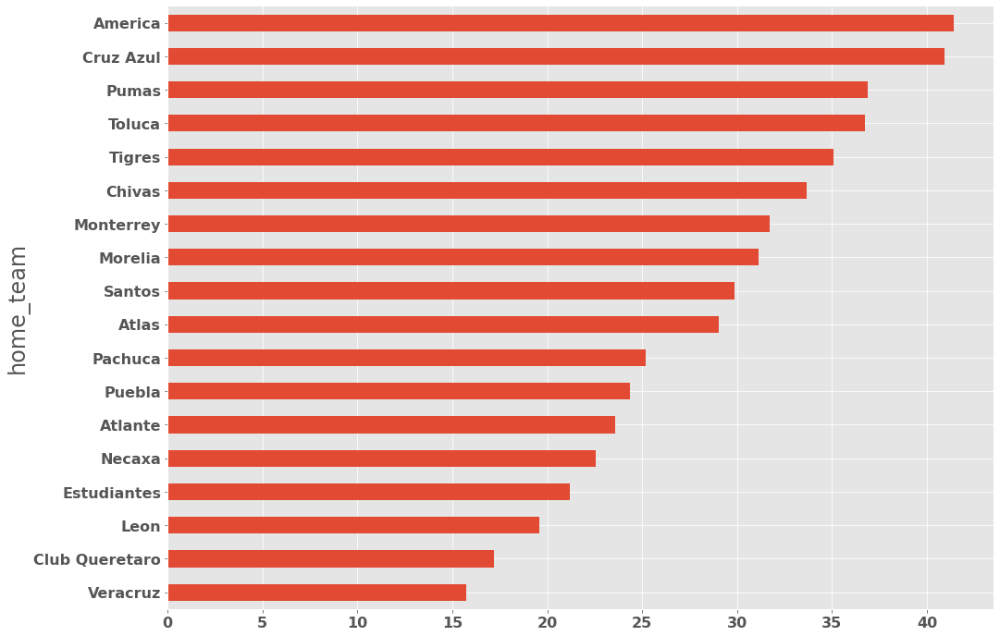

In [546]:
df_historic_games2.droplevel('index_tournament').mean().sort_values().tail(18).plot.barh()

In [549]:
df_historic_games3 = pd.concat([df_historic_games2]*2).sort_index().droplevel('index_tournament')
# Cosas de la carrera de barras
def period_summary(values, ranks):
    top2 = values.nlargest(2)
    leader = top2.index[0]
    lead = top2.iloc[0] - top2.iloc[1]
    s = f'{leader} by {lead:.2f}'
    return {'s': s, 'x': .95, 'y': .07, 'ha': 'right', 'size': 8}

bcr.bar_chart_race(df=df_historic_games3, 
                   filename=None,#'ligamx_perc_winners.mp4',
                   n_bars=10, 
                   title='Porcentaje de partidos ganados por temporada',
                   title_size=14,
                   bar_label_size=7,
                   tick_label_size=8,
                   steps_per_period=20,
                   bar_kwargs={'alpha': .7},
                   period_summary_func=period_summary,
                   perpendicular_bar_func='median',
                   scale='linear',
                   filter_column_colors=True,
                   figsize=(10, 5))

In [548]:
df_historic_games4 = df_historic_games[['index_tournament','tournament_name','home_team','gano_perc', 'perdio_perc', 'empate_perc']].melt(['index_tournament','tournament_name','home_team'])

KeyError: "['home_team'] not in index"

In [ ]:
df_historic_games4.columns = ['index_tournament','tournament_name','home_team','porcentaje', 'valor']

In [ ]:
df_historic_games4

In [282]:
agg_df_temp = agg_df.loc[:,'gano':'empate_perc'].sort_values('gano',ascending=False).drop('num_partidos',axis=1)

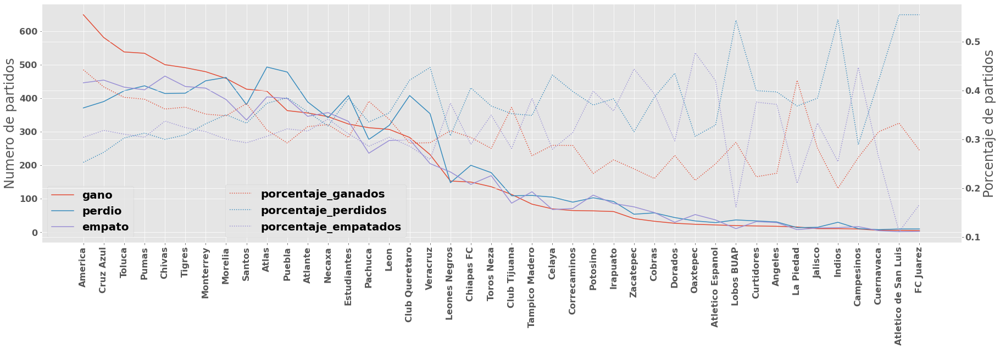

In [304]:
fig, ax = plt.subplots(figsize=(30,8))
ax.plot(agg_df_temp.loc[:,'gano':'empate'])
plt.xticks(rotation=90)
ax.set_ylabel("Numero de partidos")

# twin object for two different y-axis on the sample plot
ax2=ax.twinx()
ax2.plot(agg_df_temp.loc[:,'gano_perc':'empate_perc'], ls='dotted')
ax2.set_ylabel("Porcentaje de partidos")
ax.legend(['gano','perdio','empato'], loc='lower left' ,fontsize=20)
ax2.legend(['porcentaje_ganados','porcentaje_perdidos','porcentaje_empatados'], loc=[0.2,0.022] ,fontsize=20)


# Hagamos mas variables
* Puntos 


In [566]:
# suma de goles del equipo en el partido actual durante el torneo
df_puntos = pd.DataFrame()
for tornament in df_semiall.tournament_name.unique():
    df_res = df_semiall[df_semiall.tournament_name == tornament]
    equipos = df_res.home_team.unique()
    df_res = df_res[['tournament_name','match_date','home_team','away_team',
                     'resultado','ganador', 'FT']]
    df_res['historico_puntos_local'] = np.nan
    df_res['historico_puntos_visitante'] = np.nan

    for e1 in el:

        puntos = 0
        ind_local = df_res[df_res.home_team == e1].index.values
        ind_visitante = df_res[df_res.away_team == e1].index.values
        ind = sorted(df_res[(df_res.home_team == e1) | (df_res.away_team == e1)].index.values)
        ind_mas_uno = 0

        for match in ind:
    
            # se ponen los goles anteriores al partido actual para evitar el future leak.
            if ind[ind_mas_uno] in ind_local:
                df_res.loc[ind[ind_mas_uno], 'historico_puntos_local'] = puntos
            elif ind[ind_mas_uno] in ind_visitante:
                df_res.loc[ind[ind_mas_uno], 'historico_puntos_visitante'] = puntos

            # suma de goles
            if match in ind_local:
                if df_res.loc[match, 'resultado'] == 'local':
                    puntos = puntos + 3
                    ind_mas_uno = ind_mas_uno + 1
                elif df_res.loc[match, 'resultado'] == 'empate':
                    puntos = puntos + 1
                    ind_mas_uno = ind_mas_uno + 1
                else:
                    puntos = puntos + 0 # no vale la pena agregar esta linea pero por formalidad
                    ind_mas_uno = ind_mas_uno + 1

            elif match in ind_visitante:
                if df_res.loc[match, 'resultado'] == 'visitante':
                    puntos = puntos + 3
                    ind_mas_uno = ind_mas_uno + 1
                elif df_res.loc[match, 'resultado'] == 'empate':
                    puntos = puntos + 1
                    ind_mas_uno = ind_mas_uno + 1
                else:
                    puntos = puntos + 0 # no vale la pena agregar esta linea pero por formalidad
                    ind_mas_uno = ind_mas_uno + 1
            
    df_puntos = pd.concat([df_puntos, df_res])

In [568]:
df_puntos[(df_puntos.tournament_name == 'apertura 2019' ) & ((
    df_puntos.home_team == 'Pumas')|(df_puntos.away_team == 'Pumas'))]

,tournament_name,match_date,home_team,away_team,resultado,ganador,FT,historico_puntos_local,historico_puntos_visitante
12629,apertura 2019,2019-07-20,Atletico de San Luis,Pumas,visitante,Pumas,0-2,0.0,0.0
12643,apertura 2019,2019-07-28,Pumas,Necaxa,local,Pumas,2-0,3.0,1.0
12651,apertura 2019,2019-08-04,Pumas,Tigres,visitante,Tigres,0-1,6.0,3.0
12655,apertura 2019,2019-08-09,Club Tijuana,Pumas,local,Club Tijuana,1-0,4.0,6.0
12668,apertura 2019,2019-08-18,Pumas,Veracruz,local,Pumas,2-0,6.0,1.0
12672,apertura 2019,2019-08-23,Morelia,Pumas,local,Morelia,2-0,3.0,9.0
12688,apertura 2019,2019-08-29,Monterrey,Pumas,local,Monterrey,2-0,9.0,9.0
12695,apertura 2019,2019-09-01,Pumas,Toluca,local,Pumas,2-1,9.0,5.0
12701,apertura 2019,2019-09-14,America,Pumas,empate,empate,1-1,15.0,12.0
12715,apertura 2019,2019-09-22,Pumas,Cruz Azul,empate,empate,1-1,13.0,11.0


In [571]:
df_puntos.fillna(0,inplace=True)

In [572]:
df_puntos['diferencia_puntaje_local'] = df_puntos.historico_puntos_local - df_puntos.historico_puntos_visitante
df_puntos['diferencia_puntaje_visitante'] = df_puntos.historico_puntos_visitante - df_puntos.historico_puntos_local

In [580]:
df_semiall_pre = df_semiall.merge(df_puntos)

* Posicion de la tabla

In [578]:
df_puntos.groupby(['tournament_name','match_date'])[['home_team', 'away_team','historico_puntos_local', 'historico_puntos_visitante']]

# Pre AED


The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.

The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.

The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.

The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.


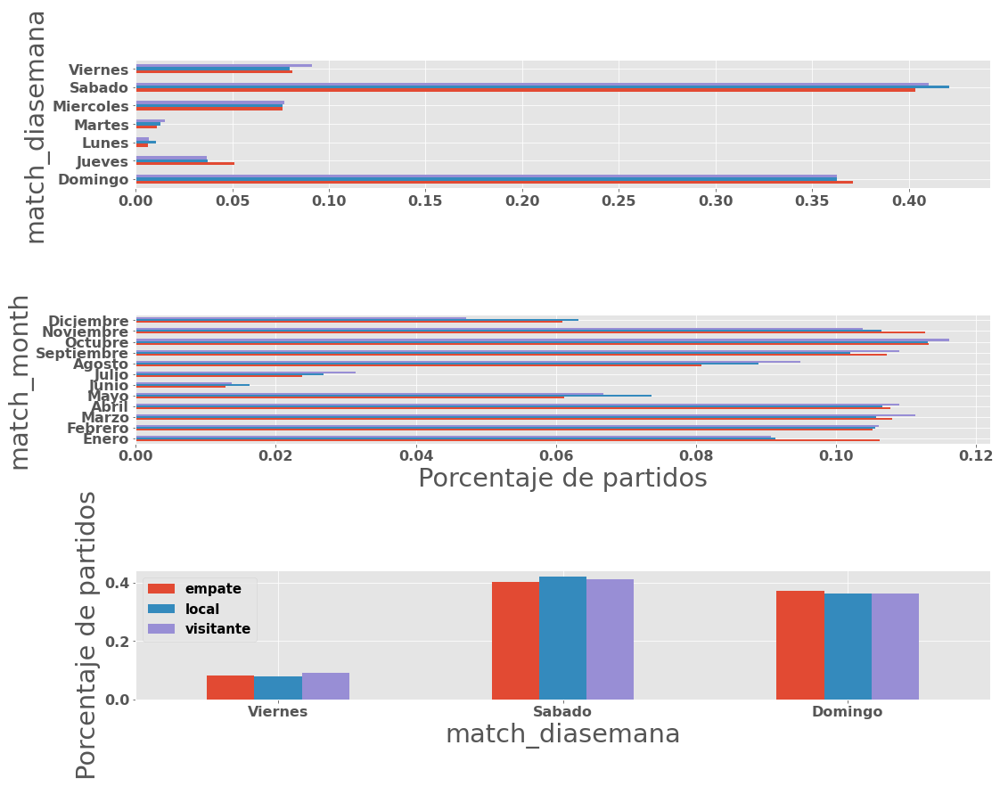

In [25]:
fig, ax = plt.subplots(3)

df.groupby("resultado").match_diasemana.value_counts(normalize=True).unstack(0).plot.barh(ax=ax[0], legend=False)

df.groupby("resultado").match_month.value_counts(
    normalize=True).unstack(0).loc[dict_month.values(),:].plot.barh(ax=ax[1], legend=False)
ax[1].set_xlabel("Porcentaje de partidos")

df.groupby("resultado").match_diasemana.value_counts(
    normalize=True).unstack(0).loc[['Viernes','Sabado','Domingo'],:].plot.bar(
    ax=ax[2], legend=True, rot=0)
ax[2].set_ylabel("Porcentaje de partidos")

plt.legend(fontsize=15)
plt.tight_layout()

In [26]:
# numero de empates
num_empates = [df[((df.home_team == team)|(df.away_team == team)) & (df.resultado == 'empate')
                 ].shape[0] for team in df.home_team.unique()]

In [27]:
empates_df = pd.DataFrame(index=df.home_team.unique(),data=num_empates,columns=['empates'])
partidos_df = df.groupby('resultado').ganador.value_counts().unstack(0).drop(
    'empate').drop('empate',axis=1).sort_values(
    ['local','visitante'],ascending=False)
partidos_df = partidos_df.join(empates_df)
partidos_df['num_partidos'] = partidos_df.sum(1)

partidos_df['perc_local'] = partidos_df.local/partidos_df.num_partidos
partidos_df['perc_visitante'] = partidos_df.visitante/partidos_df.num_partidos
partidos_df['perc_empate'] = partidos_df.empates/partidos_df.num_partidos

In [307]:
partidos_df

,local,visitante,empates,num_partidos,perc_local,perc_visitante,perc_empate
ganador,,,,,,,
America,395.0,254.0,446,1095.0,0.360731,0.231963,0.407306
Toluca,360.0,178.0,433,971.0,0.370752,0.183316,0.445932
Cruz Azul,353.0,228.0,454,1035.0,0.341063,0.220290,0.438647
Monterrey,333.0,146.0,430,909.0,0.366337,0.160616,0.473047
Tigres,331.0,160.0,435,926.0,0.357451,0.172786,0.469762
Pumas,329.0,205.0,425,959.0,0.343066,0.213764,0.443170
Chivas,302.0,198.0,466,966.0,0.312629,0.204969,0.482402
Santos,298.0,129.0,335,762.0,0.391076,0.169291,0.439633
Morelia,294.0,165.0,396,855.0,0.343860,0.192982,0.463158


In [28]:
partidos_df.num_partidos.quantile(0.50)

249.0

In [29]:
from matplotlib.colors import LinearSegmentedColormap
clist = [(0.05, 0.05, 0.05), (0.1, 0.6, 1.0),  (0.8, 0.5, 0.1)]
cmap = LinearSegmentedColormap.from_list("cmap_name", clist)

Text(0.5, 81.0, 'Porcentaje partidos ganados de')

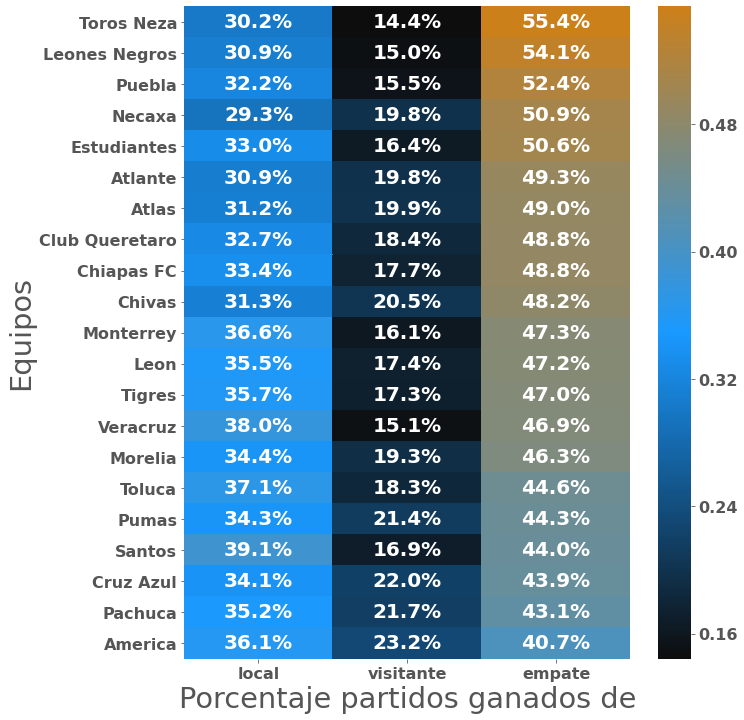

In [30]:
df['es_liguilla'] = np.where(df.match_name.str[:7] != 'Jornada',1,0)
partidos_df2 = partidos_df[partidos_df.num_partidos>250][['perc_local','perc_visitante','perc_empate']].sort_values(
    ['perc_empate','perc_local','perc_visitante'], ascending=False)
plt.figure(figsize=(10,12))
sbn.heatmap(partidos_df2,
            cmap=cmap, annot=True, fmt='.1%')
plt.xticks(ticks=[0.5,1.5,2.5], labels=['local','visitante','empate'],rotation=0)
plt.ylabel('Equipos')
plt.xlabel('Porcentaje partidos ganados de')

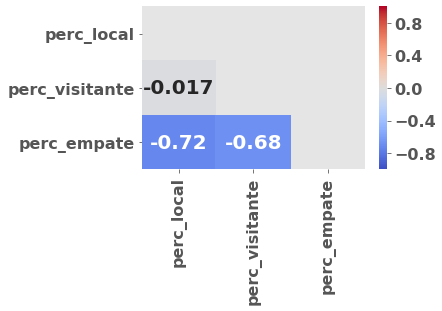

In [31]:
# Hay una correlacion entre ganar mas de local que de visitante...
corr = partidos_df2.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
plt.figure(figsize=(5,3))
sbn.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1,vmax=1,
            mask=mask)
# al parecer.... NO

Text(0.5, 0, 'Porcentaje')

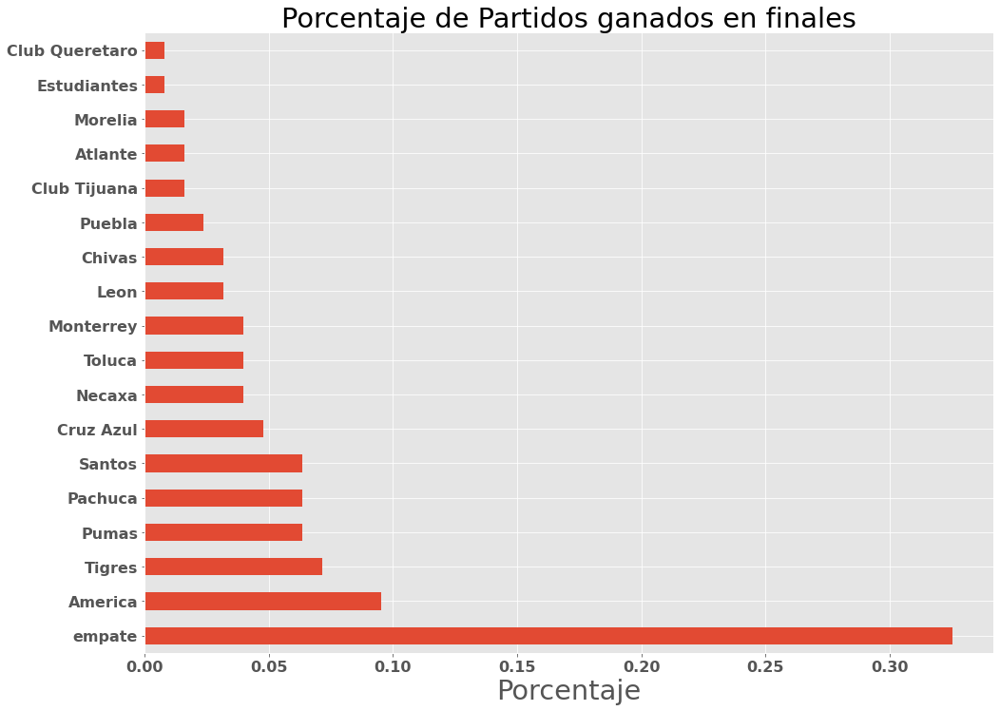

In [32]:
df[df.match_name == 'Final'].ganador.value_counts(normalize=True).plot.barh()
plt.title("Porcentaje de Partidos ganados en finales")
plt.xlabel("Porcentaje")

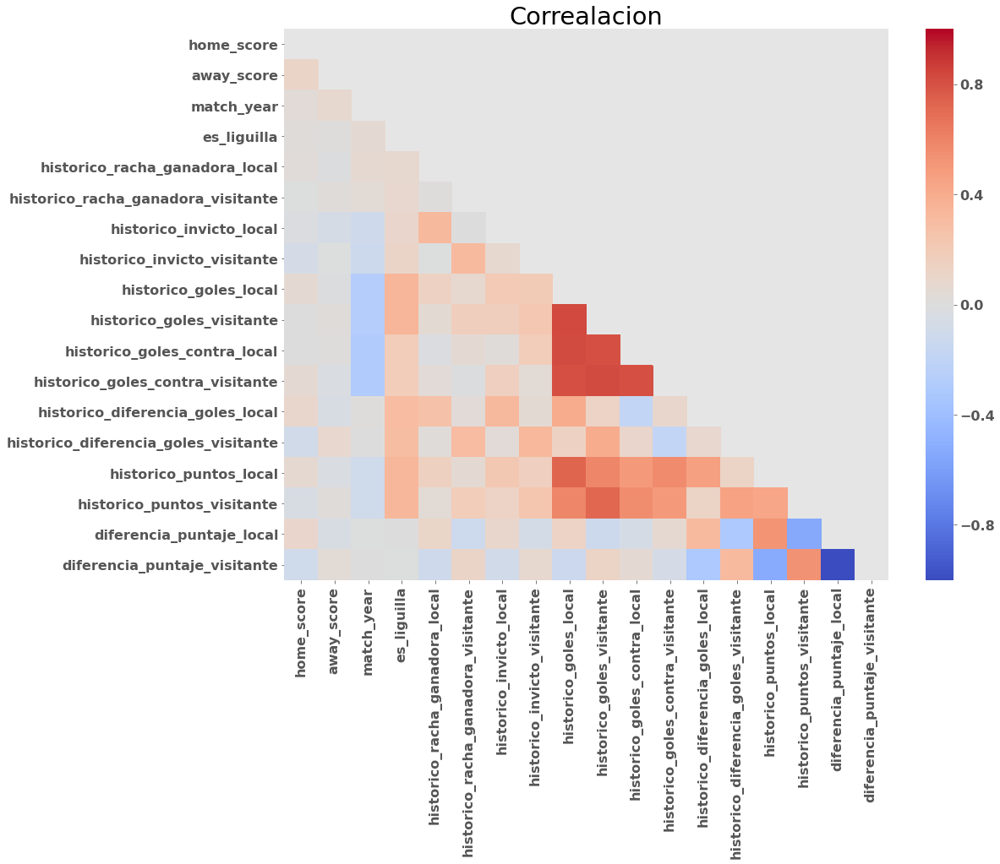

In [583]:
corr = df_semiall_pre.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
sbn.heatmap(corr, annot=False, cmap='coolwarm', vmin=-1,vmax=1,
            mask=mask,fmt='.2f')
plt.title("Correalacion");

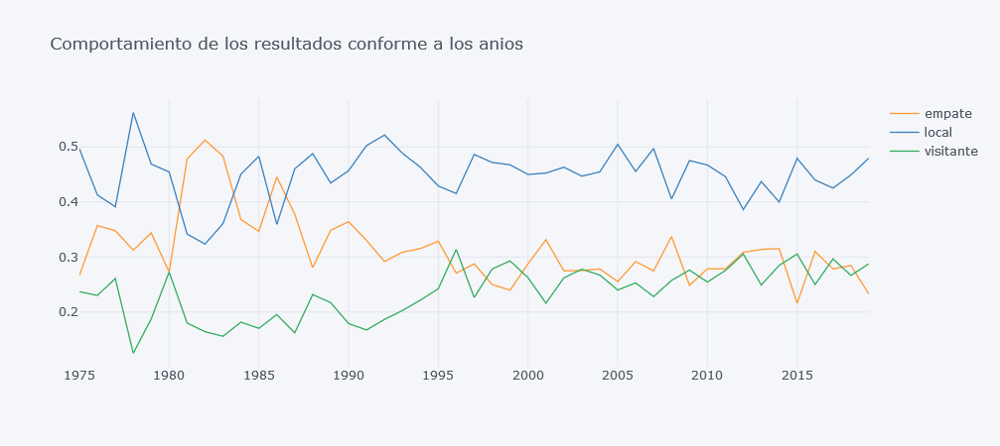

In [130]:
df_semiall.groupby(["match_year"]).resultado.value_counts(
    normalize=True).unstack().iplot(title='Comportamiento de los resultados conforme a los anios')

## Variables dummie por equipo y jornada... veamos que tal

In [584]:
df_dummies = pd.get_dummies(df_semiall_pre, columns=['match_name','home_team','away_team','match_month','match_diasemana'])

In [585]:
df_dummies.columns.tolist()

['match_date',
 'tournament_name',
 'home_score',
 'away_score',
 'match_year',
 'resultado',
 'FT',
 'ganador',
 'year_month',
 'es_liguilla',
 'historico_racha_ganadora_local',
 'historico_racha_ganadora_visitante',
 'historico_invicto_local',
 'historico_invicto_visitante',
 'historico_goles_local',
 'historico_goles_visitante',
 'historico_goles_contra_local',
 'historico_goles_contra_visitante',
 'historico_diferencia_goles_local',
 'historico_diferencia_goles_visitante',
 'historico_puntos_local',
 'historico_puntos_visitante',
 'diferencia_puntaje_local',
 'diferencia_puntaje_visitante',
 'match_name_Cuartos de Final',
 'match_name_Desempate',
 'match_name_Final',
 'match_name_Final No Descenso',
 'match_name_Jornada 1',
 'match_name_Jornada 10',
 'match_name_Jornada 11',
 'match_name_Jornada 12',
 'match_name_Jornada 13',
 'match_name_Jornada 14',
 'match_name_Jornada 15',
 'match_name_Jornada 16',
 'match_name_Jornada 17',
 'match_name_Jornada 18',
 'match_name_Jornada 19',
 'match_name_Jornada 2',
 'match_name_Jornada 20',
 'match_name_Jornada 21',
 'match_name_Jornada 22',
 'match_name_Jornada 23',
 'match_name_Jornada 24',
 'match_name_Jornada 25',
 'match_name_Jornada 26',
 'match_name_Jornada 27',
 'match_name_Jornada 28',
 'match_name_Jornada 29',
 'match_name_Jornada 3',
 'match_name_Jornada 30',
 'match_name_Jornada 31',
 'match_name_Jornada 32',
 'match_name_Jornada 33',
 'match_name_Jornada 34',
 'match_name_Jornada 35',
 'match_name_Jornada 36',
 'match_name_Jornada 37',
 'match_name_Jornada 38',
 'match_name_Jornada 39',
 'match_name_Jornada 4',
 'match_name_Jornada 40',
 'match_name_Jornada 41',
 'match_name_Jornada 42',
 'match_name_Jornada 5',
 'match_name_Jornada 6',
 'match_name_Jornada 7',
 'match_name_Jornada 8',
 'match_name_Jornada 9',
 'match_name_Repechaje',
 'match_name_Semifinales',
 'home_team_America',
 'home_team_Angeles',
 'home_team_Atlante',
 'home_team_Atlas',
 'home_team_Atletico Espanol',
 'home_team_Atletico de San Luis',
 'home_team_Campesinos',
 'home_team_Celaya',
 'home_team_Chiapas FC',
 'home_team_Chivas',
 'home_team_Club Queretaro',
 'home_team_Club Tijuana',
 'home_team_Cobras',
 'home_team_Correcaminos',
 'home_team_Cruz Azul',
 'home_team_Cuernavaca',
 'home_team_Curtidores',
 'home_team_Dorados',
 'home_team_Estudiantes',
 'home_team_FC Juarez',
 'home_team_Indios',
 'home_team_Irapuato',
 'home_team_Jalisco',
 'home_team_La Piedad',
 'home_team_Leon',
 'home_team_Leones Negros',
 'home_team_Lobos BUAP',
 'home_team_Monterrey',
 'home_team_Morelia',
 'home_team_Necaxa',
 'home_team_Oaxtepec',
 'home_team_Pachuca',
 'home_team_Potosino',
 'home_team_Puebla',
 'home_team_Pumas',
 'home_team_Santos',
 'home_team_Tampico Madero',
 'home_team_Tigres',
 'home_team_Toluca',
 'home_team_Toros Neza',
 'home_team_Veracruz',
 'home_team_Zacatepec',
 'away_team_America',
 'away_team_Angeles',
 'away_team_Atlante',
 'away_team_Atlas',
 'away_team_Atletico Espanol',
 'away_team_Atletico de San Luis',
 'away_team_Campesinos',
 'away_team_Celaya',
 'away_team_Chiapas FC',
 'away_team_Chivas',
 'away_team_Club Queretaro',
 'away_team_Club Tijuana',
 'away_team_Cobras',
 'away_team_Correcaminos',
 'away_team_Cruz Azul',
 'away_team_Cuernavaca',
 'away_team_Curtidores',
 'away_team_Dorados',
 'away_team_Estudiantes',
 'away_team_FC Juarez',
 'away_team_Indios',
 'away_team_Irapuato',
 'away_team_Jalisco',
 'away_team_La Piedad',
 'away_team_Leon',
 'away_team_Leones Negros',
 'away_team_Lobos BUAP',
 'away_team_Monterrey',
 'away_team_Morelia',
 'away_team_Necaxa',
 'away_team_Oaxtepec',
 'away_team_Pachuca',
 'away_team_Potosino',
 'away_team_Puebla',
 'away_team_Pumas',
 'away_team_Santos',
 'away_team_Tampico Madero',
 'away_team_Tigres',
 'away_team_Toluca',
 'away_team_Toros Neza',
 'away_team_Veracruz',
 'away_team_Zacatepec',
 'match_month_Abril',
 'match_month_Agosto',
 'match_month_Diciembre',
 'match_month_Enero',
 'match_month_Febrero',
 'match_month_Julio',
 'match_month_Junio',

In [586]:
not_x = ['year_month','match_date','tournament_name','match_year', 
         'resultado', 'FT', 'ganador','home_score','away_score',
#          'match_name_Jornada 19','match_name_Jornada 20', 
#          'match_name_Jornada 21', 'match_name_Jornada 22', 
#          'match_name_Jornada 23', 'match_name_Jornada 24',
#          'match_name_Jornada 25', 'match_name_Jornada 26', 
#          'match_name_Jornada 27', 'match_name_Jornada 28', 
#          'match_name_Jornada 29','match_name_Jornada 30', 
#          'match_name_Jornada 31', 'match_name_Jornada 32', 
#          'match_name_Jornada 33', 'match_name_Jornada 34', 
#          'match_name_Jornada 35', 'match_name_Jornada 36', 
#          'match_name_Jornada 37', 'match_name_Jornada 38', 
#          'match_name_Jornada 39','match_name_Jornada 40', 
#          'match_name_Jornada 41', 'match_name_Jornada 42'
        ]
x_cols = [x for x in df_dummies.columns if x not in not_x]
df_pre = df_dummies[x_cols + ['resultado']]

In [587]:
df_pre['resultado_y'] = np.where(df_pre.resultado == 'local',0,
                    np.where(df_pre.resultado == 'visitante',1,2))

# Se entrena el modelo con train, test y valid aleatoriamente

1. Se generan tres conjuntos seleccionando los registros aleatoriamente.

## Escenario 1. Con balanceo UnderSample

In [588]:
x_train, x_test_valid, y_train, y_test_valid = train_test_split(
    df_pre[x_cols],
    df_pre.resultado_y,
    test_size=0.2,
    random_state=8)

x_test, x_valid, y_test, y_valid = train_test_split(x_test_valid, 
                                                    y_test_valid,
                                                    test_size = 0.5,
                                                    random_state=8)

In [78]:
# SMOTE OVERSAMPLE
smote = SMOTE(sampling_strategy='not majority')

x_sm, y_sm = smote.fit_sample(x_train,y_train)

x_sm = pd.DataFrame(x_sm, columns=x_cols)

x_sm.shape

In [589]:
# Class count
print(y_train.value_counts())
print('//'*20)
count_class_0, count_class_1, count_class_2 = y_train.value_counts()

# Majority class
x_data_majority0 = x_train.loc[y_train == 0]
y_data_majority0 = y_train.loc[y_train == 0]

# Minority class
x_data_minority1 = x_train.loc[y_train == 1]
y_data_minority1 = y_train.loc[y_train == 1]

x_data_majority2 = x_train.loc[y_train == 2]
y_data_majority2 = y_train.loc[y_train == 2]

# y_data_minority_temp = pd.concat([y_data_minority1, y_data_minority2])
# x_data_minority_temp = pd.concat([x_data_minority1, x_data_minority2])

###########################################

y_df_major_downsampled0 = y_data_majority0.sample(n = count_class_2, random_state=69)
x_df_major_downsampled0 = x_data_majority0.loc[y_df_major_downsampled0.index]

y_df_major_downsampled2 = y_data_majority2.sample(n = count_class_2, random_state=69)
x_df_major_downsampled2 = x_data_majority2.loc[y_df_major_downsampled2.index]

y_data_downsampled = pd.concat([y_df_major_downsampled0, y_data_minority1, y_df_major_downsampled2])
x_data_downsampled = pd.concat([x_df_major_downsampled0, x_data_minority1, x_df_major_downsampled2])

y_data_downsampled.value_counts()

0    4566
2    3233
1    2443
Name: resultado_y, dtype: int64
////////////////////////////////////////


2    2443
1    2443
0    2443
Name: resultado_y, dtype: int64

## Primero modelo un lightgbm

In [590]:
# d_train = lgb.Dataset(x_sm, y_sm)
d_train = lgb.Dataset(x_data_downsampled, label=y_data_downsampled)
d_valid = lgb.Dataset(x_valid, label=y_valid)

params = {}
params['learning_rate'] = 0.001
params['boosting_type'] = 'gbdt'
params['objective'] = 'multiclass'
params['num_class'] = 3
params['metric'] = 'multi_logloss'
params['sub_feature'] = 0.2
params['num_leaves'] = 30
params['min_data'] = 4
params['max_depth'] = 1000
params['num_iterations'] = 60000

clf = lgb.train(params, d_train, 100, valid_sets=[d_valid], early_stopping_rounds=100, verbose_eval=10000)

C:\Users\serch\Anaconda3\lib\site-packages\lightgbm\engine.py:148: UserWarning:

Found `num_iterations` in params. Will use it instead of argument



Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[4051]	valid_0's multi_logloss: 1.08015


In [591]:
y_pred=clf.predict(x_test)
predictions = []

for x in y_pred:
    predictions.append(np.argmax(x))

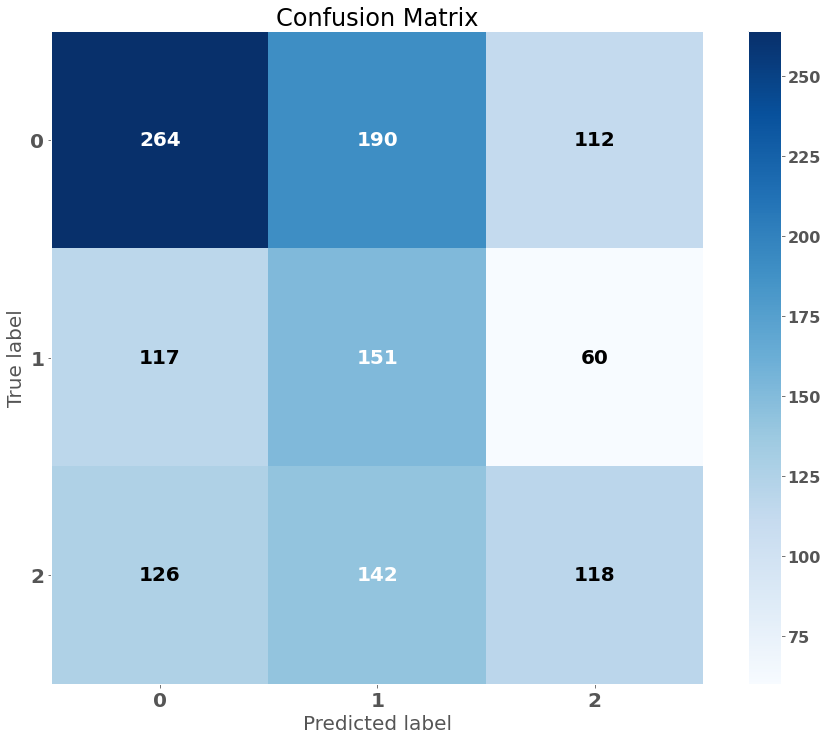

In [592]:
skplt.metrics.plot_confusion_matrix(y_test,predictions,cmap='Blues',normalize=False)

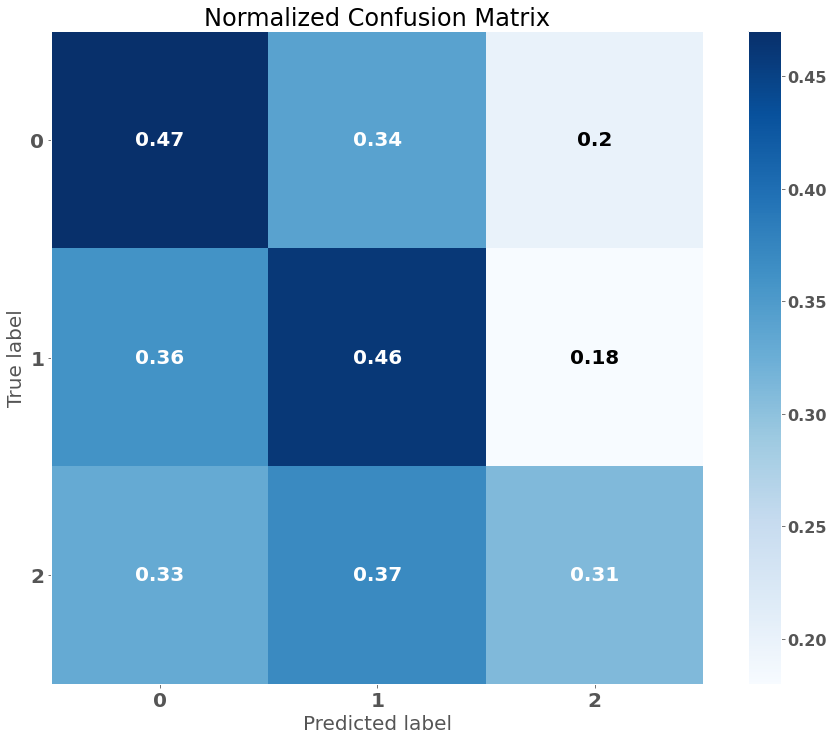

In [593]:
skplt.metrics.plot_confusion_matrix(y_test,predictions,cmap='Blues',normalize=True)

In [594]:
clf.best_score

defaultdict(collections.OrderedDict,
            {'valid_0': OrderedDict([('multi_logloss', 1.0801545234276442)])})

In [595]:
def multi_class_roc(class_code):

    return roc_auc_score(np.where(y_test==class_code, 1,0), 
                  [val[class_code] for val in clf.predict(x_test)])


local_roc = multi_class_roc(0)
visitante_roc = multi_class_roc(1)
empate_roc = multi_class_roc(2)
print('roc auc score local = {0:5.5f}'.format(local_roc))
print('roc auc score visitante = {0:5.5f}'.format(visitante_roc))
print('roc auc score empate = {0:5.5f}'.format(empate_roc))
print('promedio roc auc score = {0:5.5f}'.format(np.mean([local_roc,
                                                      visitante_roc,
                                                      empate_roc])))

roc auc score local = 0.57784
roc auc score visitante = 0.57367
roc auc score empate = 0.53467
promedio roc auc score = 0.56206


In [596]:
print('accuracy score', round(accuracy_score(y_test,predictions),4))

accuracy score 0.4164


# 2do. Modelo XGBOOST

In [621]:
def modelfit(alg, xtrain,ytrain, xtest,ytest,useTrainCV=True, cv_folds=5, early_stopping_rounds=50):
    
    if useTrainCV:
        xgb_param = alg.get_xgb_params()
        xgb_param['num_class'] = 3
        xgtrain = xgb.DMatrix(xtrain.values, label=ytrain.values)
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics='mlogloss', early_stopping_rounds=early_stopping_rounds, verbose_eval=True)
        alg.set_params(n_estimators=cvresult.shape[0])
    
    #Fit the algorithm on the data
    alg.fit(xtrain, ytrain, eval_metric='mlogloss')
        
    #Predict training set:
    dtrain_predictions = alg.predict(xtest)
    dtrain_predprob = alg.predict_proba(xtest)[:,1]
        
    #Print model report:
    print ("\nModel Report")
    print ("Accuracy : %.4g" % accuracy_score(ytest.values, dtrain_predictions))
                    
    return (alg)

In [622]:
from xgboost import XGBClassifier
import xgboost as xgb

xgb1 = XGBClassifier(
         learning_rate =0.01,
         n_estimators=500,
         max_depth=4,
         min_child_weight=1,
         gamma=0.2,
         subsample=0.8,
         colsample_bytree=0.8,
         objective= 'multi:softprob',
         nthread=4,
         seed=8)
clf_xgboost = modelfit(xgb1, x_data_downsampled, y_data_downsampled, x_valid,y_valid)

[0]	train-mlogloss:1.09823+0.00002	test-mlogloss:1.09843+0.00004
[1]	train-mlogloss:1.09784+0.00006	test-mlogloss:1.09825+0.00004
[2]	train-mlogloss:1.09746+0.00008	test-mlogloss:1.09809+0.00005
[3]	train-mlogloss:1.09709+0.00009	test-mlogloss:1.09793+0.00007
[4]	train-mlogloss:1.09673+0.00010	test-mlogloss:1.09774+0.00008
[5]	train-mlogloss:1.09636+0.00012	test-mlogloss:1.09757+0.00010
[6]	train-mlogloss:1.09600+0.00012	test-mlogloss:1.09741+0.00013
[7]	train-mlogloss:1.09563+0.00014	test-mlogloss:1.09725+0.00014
[8]	train-mlogloss:1.09528+0.00016	test-mlogloss:1.09710+0.00014
[9]	train-mlogloss:1.09488+0.00016	test-mlogloss:1.09693+0.00013
[10]	train-mlogloss:1.09455+0.00016	test-mlogloss:1.09681+0.00013
[11]	train-mlogloss:1.09418+0.00015	test-mlogloss:1.09666+0.00016
[12]	train-mlogloss:1.09384+0.00017	test-mlogloss:1.09650+0.00019
[13]	train-mlogloss:1.09351+0.00021	test-mlogloss:1.09635+0.00022
[14]	train-mlogloss:1.09316+0.00022	test-mlogloss:1.09621+0.00025
[15]	train-mlogloss:

In [629]:
pd.DataFrame(clf_xgboost.feature_importances_, x_data_downsampled.columns).sort_values(0).tail(10)

,0
diferencia_puntaje_visitante,0.008870
away_team_Potosino,0.008957
home_team_Club Queretaro,0.009273
diferencia_puntaje_local,0.009325
away_team_Cruz Azul,0.009365
away_team_Veracruz,0.009453
historico_diferencia_goles_visitante,0.009648
away_team_Chivas,0.009983
away_team_Tampico Madero,0.010020
away_team_America,0.013027


In [597]:
dic_resultado = {0:'local',1:'visitante',2:'empate'}

In [598]:
dic_resultado

{0: 'local', 1: 'visitante', 2: 'empate'}

## Interpretacion SE HACE EN TRAIN

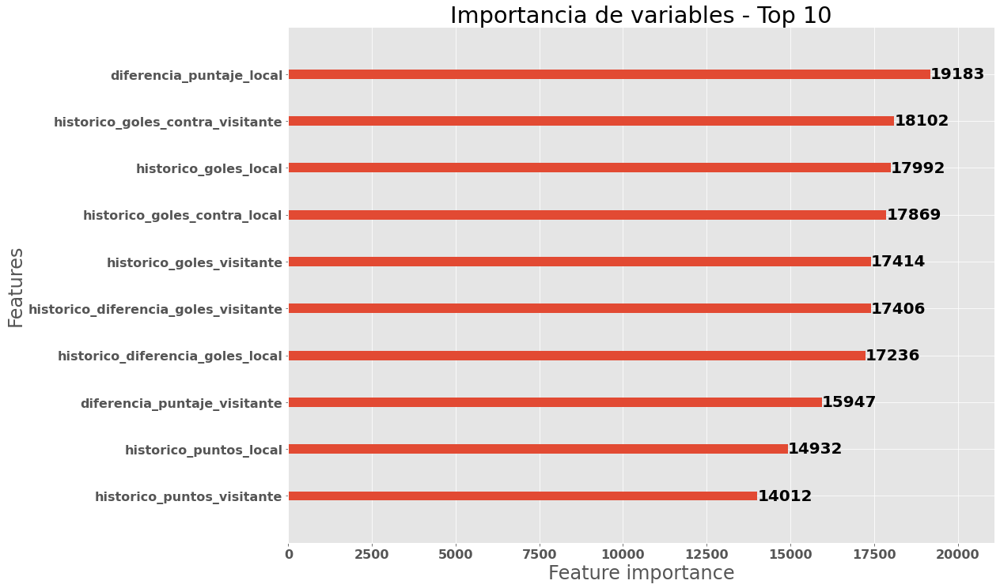

In [599]:
lgb.plot_importance(clf, max_num_features=10, title='Importancia de variables - Top 10')

In [600]:
f_imp = []
for i in zip(x_train.columns,clf.feature_importance()):
    f_imp.append(i)
    
importancia = pd.DataFrame(f_imp,columns=['col','value_imp']).sort_values(by='value_imp',ascending=False)
importancia = importancia.head(10)

In [601]:
pd.DataFrame(f_imp,columns=['col','value_imp']).sort_values(by='value_imp',ascending=False)

,col,value_imp
13,diferencia_puntaje_local,19183
8,historico_goles_contra_visitante,18102
5,historico_goles_local,17992
7,historico_goles_contra_local,17869
6,historico_goles_visitante,17414
...,...,...
125,away_team_Indios,26
51,match_name_Jornada 39,0
16,match_name_Desempate,0
124,away_team_FC Juarez,0


In [132]:
explainer = shap.TreeExplainer(clf)
shap_values = explainer.shap_values(x_test)

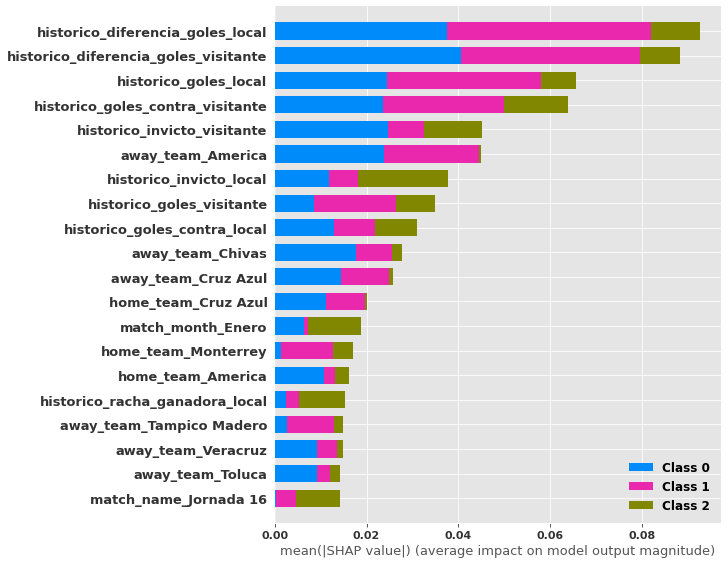

In [133]:
shap.summary_plot(shap_values, x_test)

In [143]:
dic_resultado

{0: 'local', 1: 'visitante', 2: 'empate'}

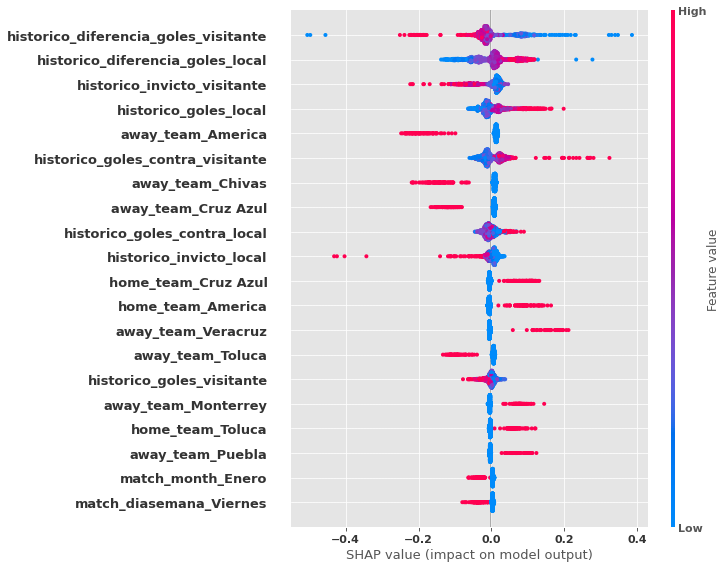

local


In [144]:
shap.summary_plot(shap_values[0], x_test)
print('local')

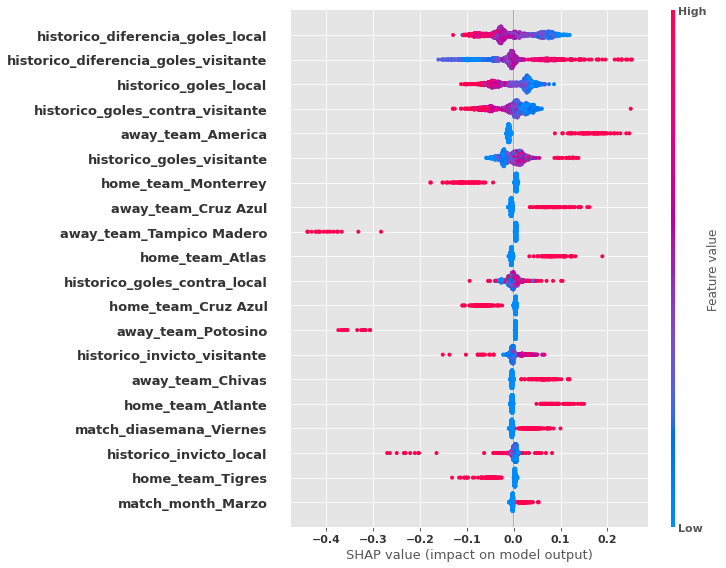

visitante


In [145]:
shap.summary_plot(shap_values[1], x_test)
print('visitante')

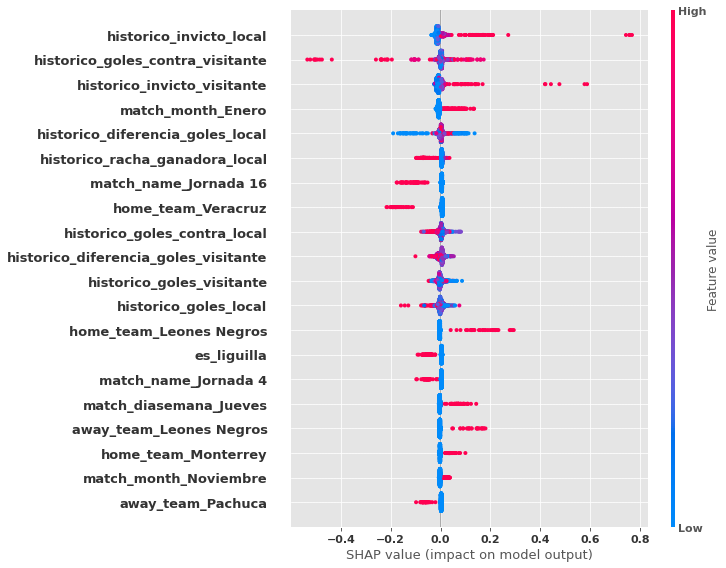

Empate


In [146]:
shap.summary_plot(shap_values[2], x_test)
print('Empate')

In [134]:
shap.initjs()

In [135]:
shap.force_plot(explainer.expected_value[0], shap_values[0], x_test)